In [2]:
import datetime
import pandas as pd
import geopandas as gpd
import numpy as np
import json
import matplotlib.pyplot as plt
import os
from tqdm import tqdm_notebook
plt.rcParams['figure.figsize'] = (40, 40)
import numpy as np
import matplotlib.pyplot as plt
from descartes import PolygonPatch
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.collections as mcoll

In [4]:
os.listdir()

['Unknown-2.png',
 'toda_la_red.png',
 'estaciones_por_actividad.png',
 'Unknown.png',
 'viajes.csv',
 'Unknown-17.png',
 '2019-09.csv',
 '10000.png',
 'stations.csv',
 'num_viajes.png',
 'Unknown4.png',
 'prueba.png',
 'unknown1.png',
 'Unknown3.png',
 'Unknown2.png',
 '.ipynb_checkpoints',
 'mapa.png',
 '1.png',
 'ecoviz.ipynb']

## Leer datos
* **df** son las estaciones
* **df2** es la lista de todos los viajes
* **df3** son los agregados de cada viaje.


In [61]:
df2=pd.read_csv('2019-09.csv')
df2.head()

,Genero_Usuario,Edad_Usuario,Bici,Ciclo_Estacion_Retiro,Fecha_Retiro,Hora_Retiro,Ciclo_Estacion_Arribo,Fecha_Arribo,Hora_Arribo
0,M,30,7685,136,01/09/2019,0:00:54,256,01/09/2019,0:08:28
1,M,37,7729,56,01/09/2019,0:01:07,186,01/09/2019,0:15:21
2,M,22,9555,404,01/09/2019,0:01:12,119,01/09/2019,0:25:26
3,M,28,15231,260,01/09/2019,0:01:15,260,01/09/2019,0:27:56
4,M,42,11867,325,01/09/2019,0:01:39,347,01/09/2019,0:05:06


In [3]:
df=pd.read_csv('stations.csv')
df.head()

,id,lat,lon,name
0,1,19.433571,-99.167809,1 RIO SENA-RIO BALSAS
1,2,19.431386,-99.171695,2 RIO GUADALQUIVIR-RIO BALSAS
2,3,19.431655,-99.158668,3 REFORMA-INSURGENTES
3,4,19.428309,-99.171713,4 RIO NILO-RIO PANUCO
4,5,19.429720,-99.169363,5 RIO PANUCO-RIO TIBER


In [4]:
path='../alcaldias.geojson.json'
data_f = gpd.read_file(path)
data_f

,cvegeo,nomgeo,cve_mun,cve_ent,geometry
0,09012,Tlalpan,012,09,POLYGON ((-99.19628607999992 19.30227816999913...
1,09017,Venustiano Carranza,017,09,POLYGON ((-99.10894588999996 19.45273362999915...
2,09002,Azcapotzalco,002,09,POLYGON ((-99.18230696999991 19.50747924999914...
3,09007,Iztapalapa,007,09,POLYGON ((-99.05813287699995 19.40071958499914...
4,09006,Iztacalco,006,09,POLYGON ((-99.05583625999996 19.42196122999907...
5,09016,Miguel Hidalgo,016,09,POLYGON ((-99.19057941999993 19.46793631999912...
6,09008,La Magdalena Contreras,008,09,"POLYGON ((-99.208589 19.33609616999916, -99.20..."
7,09003,Coyoacán,003,09,POLYGON ((-99.13923187999993 19.35686528999909...
8,09009,Milpa Alta,009,09,POLYGON ((-98.99723373999994 19.22731068999911...
9,09015,Cuauhtémoc,015,09,"POLYGON ((-99.1291909399999 19.46246651999916,..."


In [26]:
data_f['geometry'].loc[data_f['nomgeo']=='Miguel Hidalgo']

5    POLYGON ((-99.19057941999993 19.46793631999912...
Name: geometry, dtype: object

In [6]:
%matplotlib inline

# Alcaldías con las estaciones ecobicis

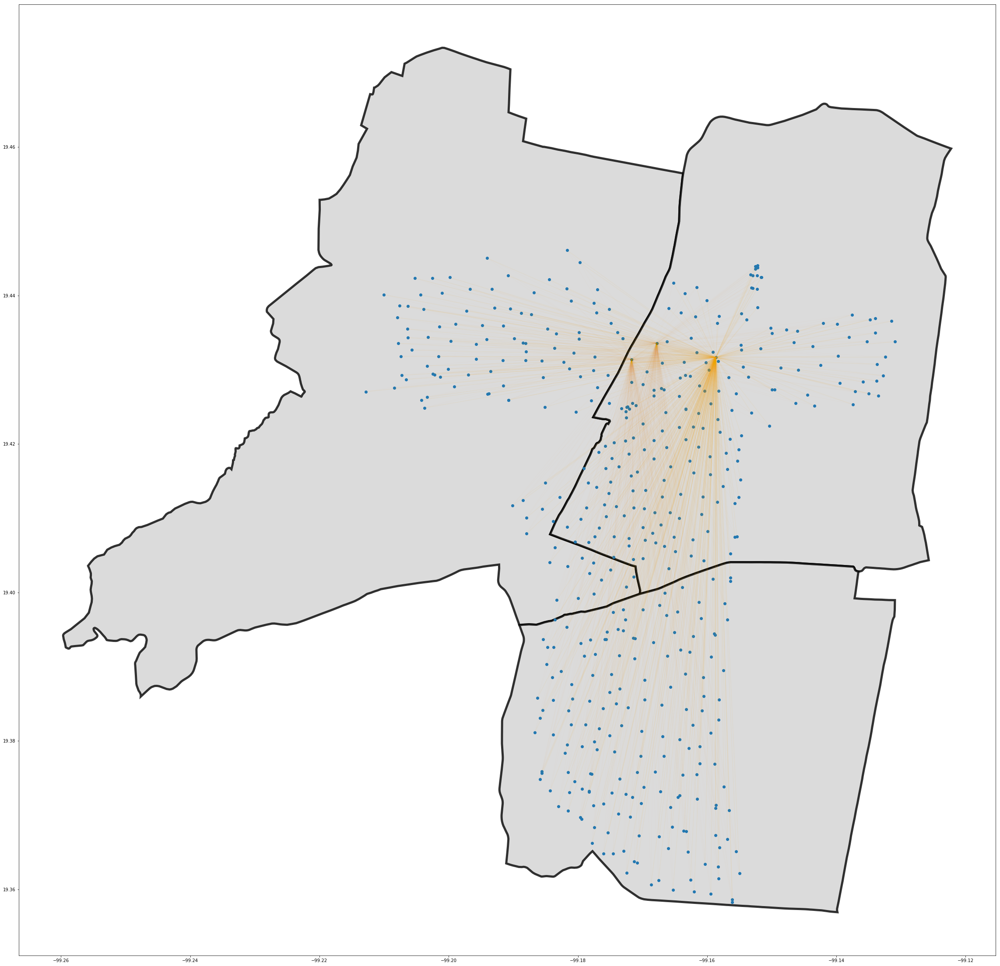

In [47]:
fig,ax=plt.subplots()
for idx,alcaldia in data_f.iterrows():
    if(alcaldia['nomgeo'] in ['Miguel Hidalgo','Benito Juárez','Cuauhtémoc']):
        ax.add_patch(PolygonPatch(alcaldia['geometry'], fc='lightgrey', ec='black',alpha=.8,linewidth=5))
plt.plot(df['lon'],df['lat'],'o')    
biciestacion=df.loc[0]
for i in range(idx,df.shape[0]):
    lats=[biciestacion['lat'],df['lat'].loc[i]]
    lons=[biciestacion['lon'],df['lon'].loc[i]]
    plt.plot(lons,lats,color='orange',alpha=.01)
biciestacion=df.loc[1]
for i in range(idx,df.shape[0]):
    lats=[biciestacion['lat'],df['lat'].loc[i]]
    lons=[biciestacion['lon'],df['lon'].loc[i]]
    plt.plot(lons,lats,color='orange',alpha=.01)
biciestacion=df.loc[2]    
for i in range(idx,df.shape[0]):
    lats=[biciestacion['lat'],df['lat'].loc[i]]
    lons=[biciestacion['lon'],df['lon'].loc[i]]
    plt.plot(lons,lats,color='orange',alpha=.05)

## Todos los caminos

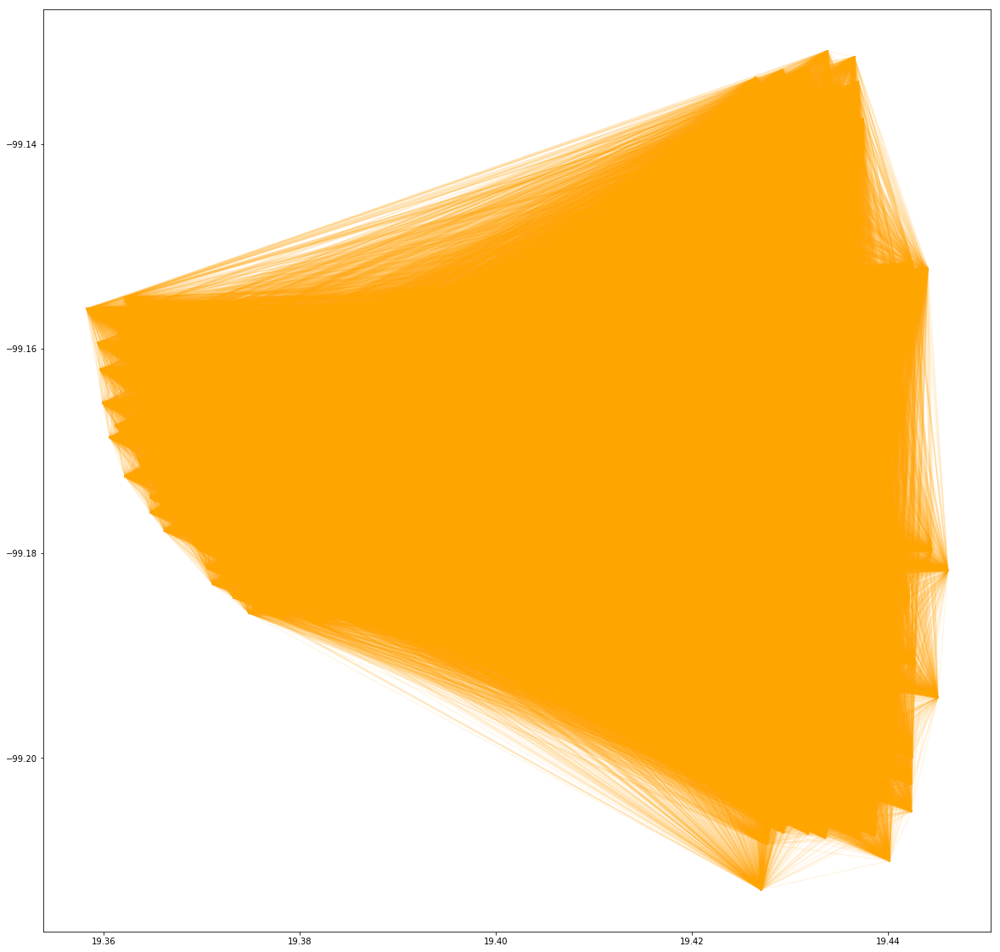

In [34]:
fig,ax=plt.subplots()
for idx,biciestacion in tqdm_notebook(df.iterrows(),total=df.shape[0]):
    for i in range(idx+1,df.shape[0]):
        lats=[biciestacion['lat'],df['lat'].loc[i]]
        lons=[biciestacion['lon'],df['lon'].loc[i]]
        ax.plot(lons,lats,color='orange',alpha=.01)

# Todos los caminos desde la estación 0

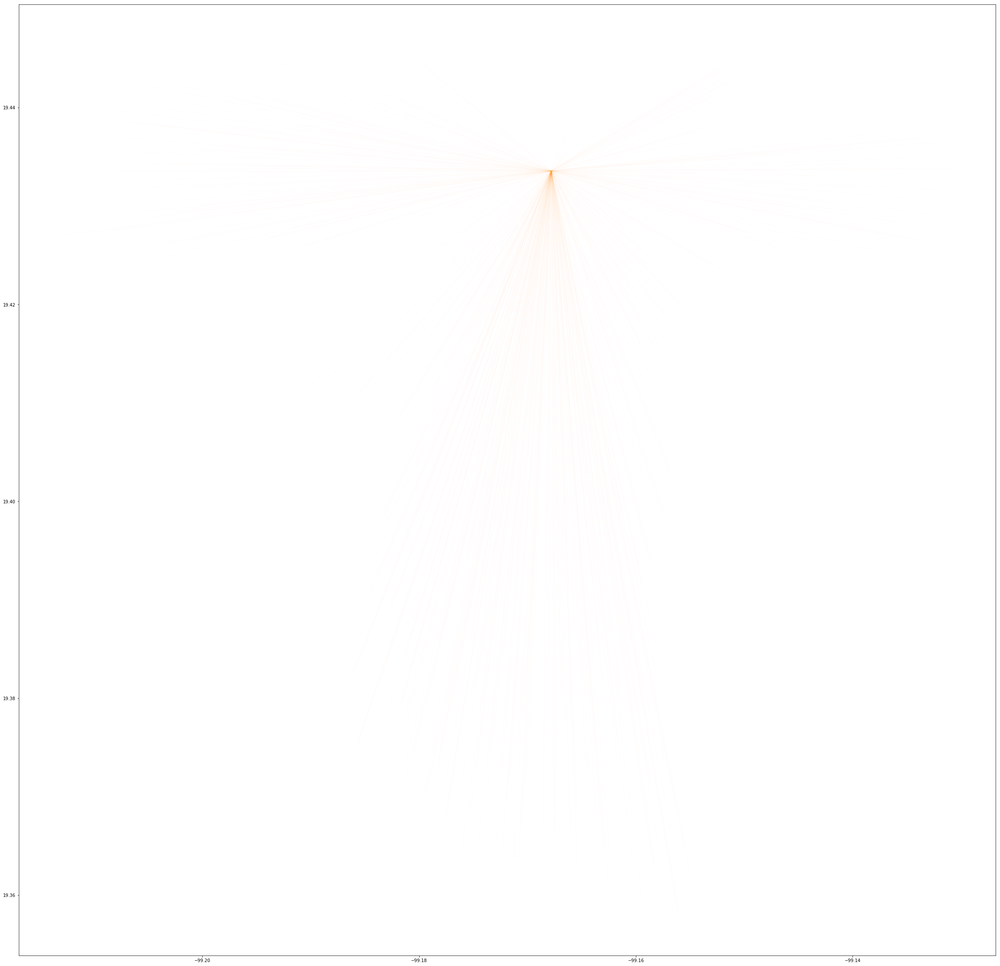

In [42]:
fig,ax=plt.subplots()
biciestacion=df.loc[0]
for i in range(1,df.shape[0]):
    lats=[biciestacion['lat'],df['lat'].loc[i]]
    lons=[biciestacion['lon'],df['lon'].loc[i]]
    plt.plot(lons,lats,color='orange')

## Las primeras n rutas de septiembre

Toda se tardaría mucho...

In [56]:
df2.describe()

,Edad_Usuario,Bici,Ciclo_Estacion_Retiro,Ciclo_Estacion_Arribo
count,673820.000000,673820.000000,673820.000000,673820.000000
mean,35.129616,9253.182846,185.592721,182.465629
std,10.336424,2666.614173,133.458532,133.880569
min,16.000000,1149.000000,1.000000,1.000000
25%,28.000000,7763.000000,66.000000,64.000000
50%,32.000000,9410.000000,166.000000,160.000000
75%,40.000000,11228.000000,278.000000,274.000000
max,119.000000,15339.000000,3001.000000,3002.000000


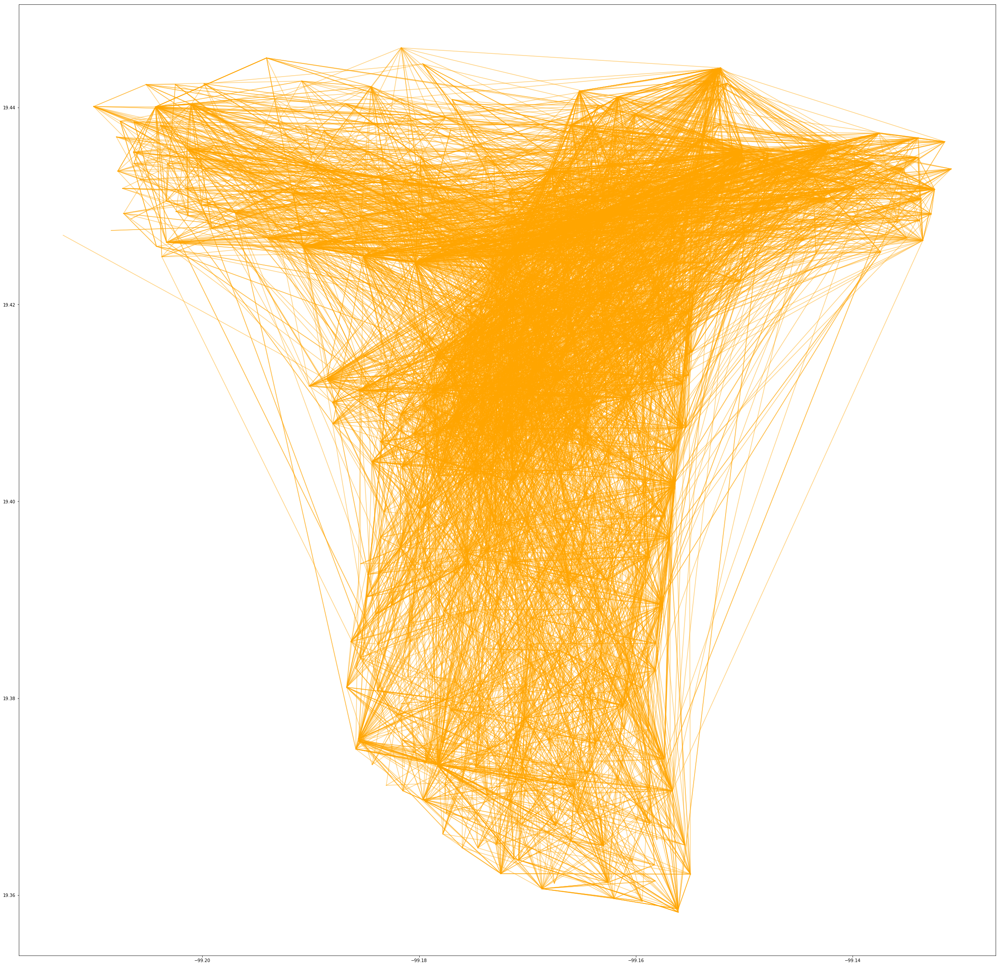

In [63]:
fig,ax=plt.subplots()
for idx in tqdm_notebook(range(10000)):
    viaje=df2.loc[idx]
    if(viaje['Ciclo_Estacion_Retiro']<481 and viaje['Ciclo_Estacion_Arribo']<481):
        lats=[df['lat'].loc[viaje['Ciclo_Estacion_Retiro']-1],df['lat'].loc[viaje['Ciclo_Estacion_Arribo']-1]]
        lons=[df['lon'].loc[viaje['Ciclo_Estacion_Retiro']-1],df['lon'].loc[viaje['Ciclo_Estacion_Arribo']-1]]
        ax.plot(lons,lats,color='orange',alpha=.5)
        

## Agregar los datos

A df se le añaden las columnas `num_retiros`, `num_arribos` y `act` que la cantidad de los retiros, arribos y el agregado por cada estación.

In [66]:
df['num_arribos']=np.zeros(df.shape[0])
for idx,estacion in tqdm_notebook(df.iterrows(),total=df.shape[0]):
    df['num_arribos'].loc[idx]=sum(df2['Ciclo_Estacion_Arribo']==estacion['id'])
df['num_retiros']=np.zeros(df.shape[0])
for idx,estacion in tqdm_notebook(df.iterrows(),total=df.shape[0]):
    df['num_retiros'].loc[idx]=sum(df2['Ciclo_Estacion_Retiro']==estacion['id'])
df['act']=df['num_arribos']+df['num_retiros']
df.head()

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:189: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._setitem_with_indexer(indexer, value)


,id,lat,lon,name,num_arribos,num_retiros,act
0,1,19.433571,-99.167809,1 RIO SENA-RIO BALSAS,5957.0,5773.0,11730.0
1,2,19.431386,-99.171695,2 RIO GUADALQUIVIR-RIO BALSAS,1912.0,1950.0,3862.0
2,3,19.431655,-99.158668,3 REFORMA-INSURGENTES,2036.0,2208.0,4244.0
3,4,19.428309,-99.171713,4 RIO NILO-RIO PANUCO,2025.0,1760.0,3785.0
4,5,19.429720,-99.169363,5 RIO PANUCO-RIO TIBER,2060.0,1954.0,4014.0


In [67]:
df.to_csv('stations_procesadas.csv')

# Plotear la actividad por cada estacion

In [90]:
import seaborn as sns

In [100]:
naranja=[255,144,80]
azul=[32,120,145]
import colorsys
(h1,l1,s1)=colorsys.rgb_to_hls(naranja[0]/255, naranja[1]/255, naranja[2]/255)
(h2,l2,s2)=colorsys.rgb_to_hls(azul[0]/255, azul[1]/255, azul[2]/255)


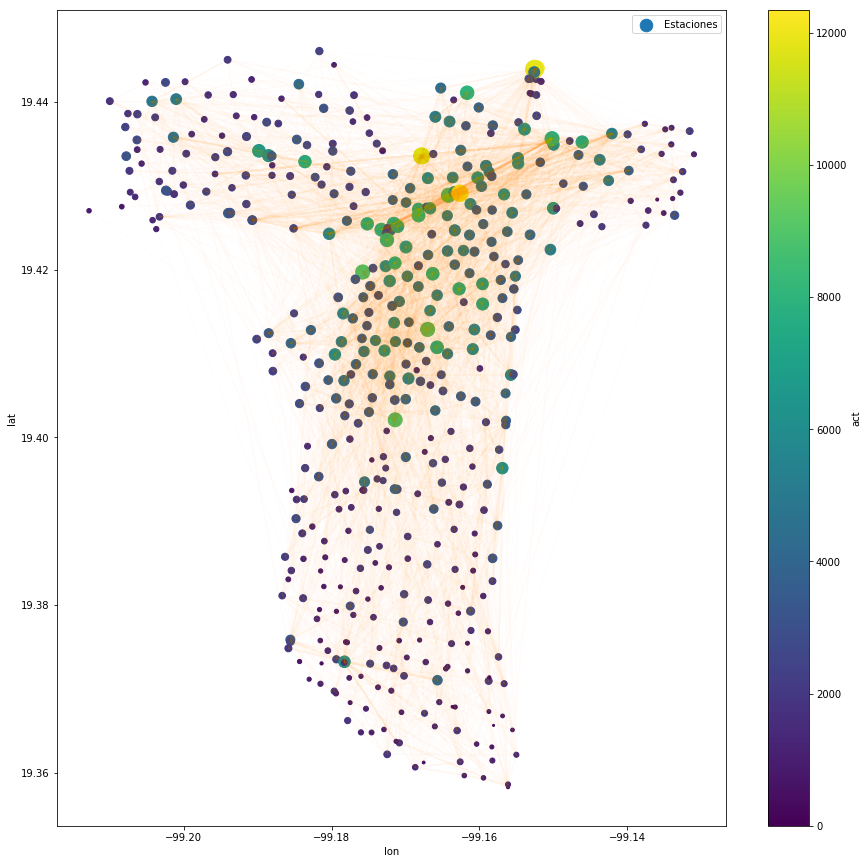

In [113]:
fig,ax=plt.subplots()
for idx in tqdm_notebook(range(10000)):
    viaje=df2.loc[idx]
    if(viaje['Ciclo_Estacion_Retiro']<481 and viaje['Ciclo_Estacion_Arribo']<481):
        lats=[df['lat'].loc[viaje['Ciclo_Estacion_Retiro']-1],df['lat'].loc[viaje['Ciclo_Estacion_Arribo']-1]]
        lons=[df['lon'].loc[viaje['Ciclo_Estacion_Retiro']-1],df['lon'].loc[viaje['Ciclo_Estacion_Arribo']-1]]
        ax.plot(lons,lats,color='orange',alpha=.01)
ax=df.plot(kind="scatter", x="lon", y="lat",
    s=df['num_retiros']/22, label="Estaciones",
    c="act", cmap='viridis',
    colorbar=True, figsize=(15,15),
ax=ax
       )

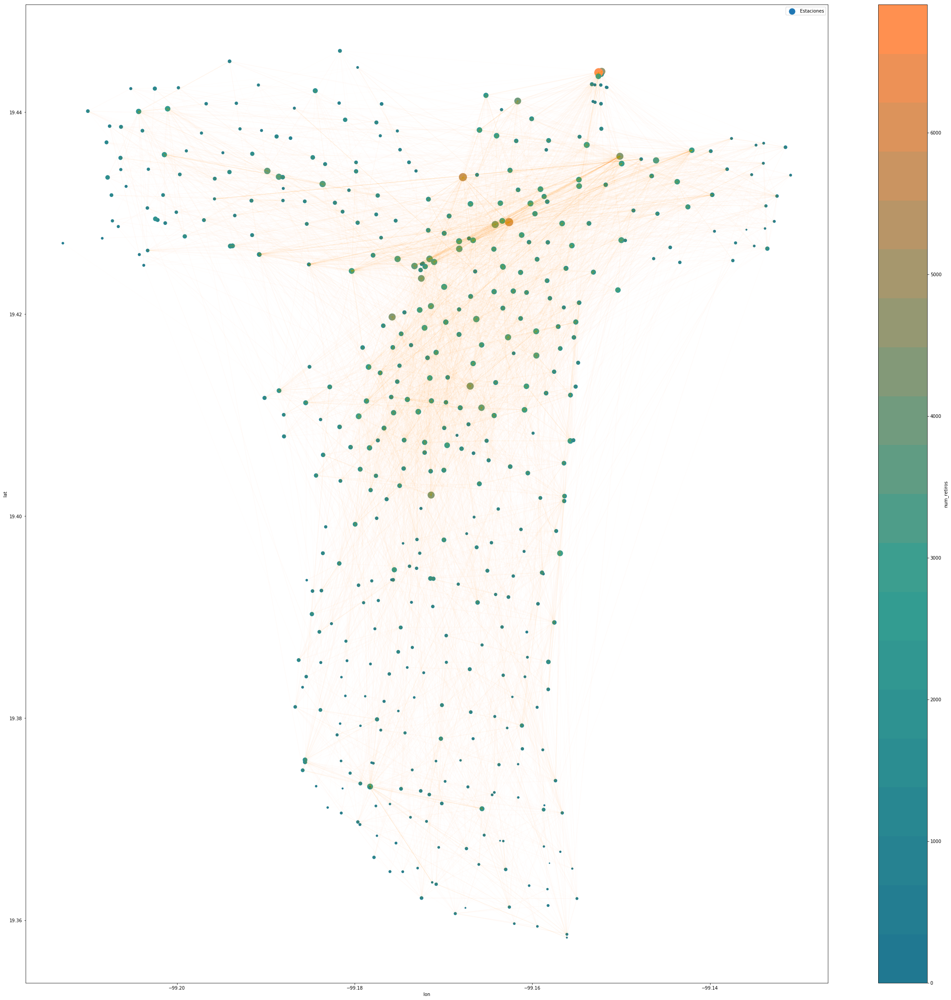

In [128]:
verde=[53,159,145]
azul=[32,120,145]
cdict = {'red':   [[0.0,  azul[0]/255, azul[0]/255],
                    [.4,verde[0]/255,verde[0]/255],


                   [1,  naranja[0]/255,naranja[0]/255]],
         'green': [[0.0,  azul[1]/255, azul[1]/255],
                    [.4,verde[1]/255,verde[1]/255],


                   [1,  naranja[1]/255,naranja[1]/255]],
         'blue':  [[0.0,  azul[2]/255,azul[2]/255],
                   [.4,verde[2]/255,verde[2]/255],
                   [1,  naranja[2]/255,naranja[2]/255]]}
datalab_cmap= LinearSegmentedColormap('datalabCmap', segmentdata=cdict, N=20)
fig,ax=plt.subplots()
for idx in tqdm_notebook(range(10000)):
    viaje=df2.loc[idx]
    if(viaje['Ciclo_Estacion_Retiro']<481 and viaje['Ciclo_Estacion_Arribo']<481):
        lats=[df['lat'].loc[viaje['Ciclo_Estacion_Retiro']-1],df['lat'].loc[viaje['Ciclo_Estacion_Arribo']-1]]
        lons=[df['lon'].loc[viaje['Ciclo_Estacion_Retiro']-1],df['lon'].loc[viaje['Ciclo_Estacion_Arribo']-1]]
        ax.plot(lons,lats,color='orange',alpha=.01)
ax=df.plot(kind="scatter", x="lon", y="lat",
    s=df['num_retiros']/20, label="Estaciones",
    c="num_retiros", cmap=datalab_cmap,
    colorbar=True, figsize=(40,40),
ax=ax
       )

### Conseguir Todas las rutas diferentes con su respectivo peso y definir eso como su alpha y graficarlas todas.

In [96]:
import pandas as pd

In [202]:
df3 = pd.read_csv('viajes.csv')
df=pd.read_csv('stations_procesadas.csv')
df=df.set_index('id')
df['balance']=(df['num_arribos']-df['num_retiros'])/df['act']
df.head()

FileNotFoundError: File b'viajes.csv' does not exist

In [203]:
df4=df3.join(df,on='retiro',how='inner',lsuffix='_caller', rsuffix='_other')

NameError: name 'df3' is not defined

In [198]:
df4=df4.join(df,on='arribo',how='inner',lsuffix='_caller', rsuffix='_other')

NameError: name 'df4' is not defined

In [199]:
df4.head()

NameError: name 'df4' is not defined

In [200]:
df4=df4.sort_values(by='num_viajes',ascending=True)
segments=[]
for i,row in tqdm_notebook(df4.iterrows(),total=df4.shape[0]):
    segments.append([[row['lon_caller'],row['lat_caller']],[row['lon_other'],row['lat_other']]])  

NameError: name 'df4' is not defined

In [16]:
from matplotlib import cm
import colorsys
import seaborn as sns
naranja=[255,144,80]
azul=[32,120,145]
(h1,l1,s1)=colorsys.rgb_to_hls(naranja[0]/255, naranja[1]/255, naranja[2]/255)
(h2,l2,s2)=colorsys.rgb_to_hls(azul[0]/255, azul[1]/255, azul[2]/255)
cmap=sns.diverging_palette(h1*359,h2*359,n=40,s=s1*99, center="light",l=l1*99,as_cmap=True)

NameError: name 'df' is not defined

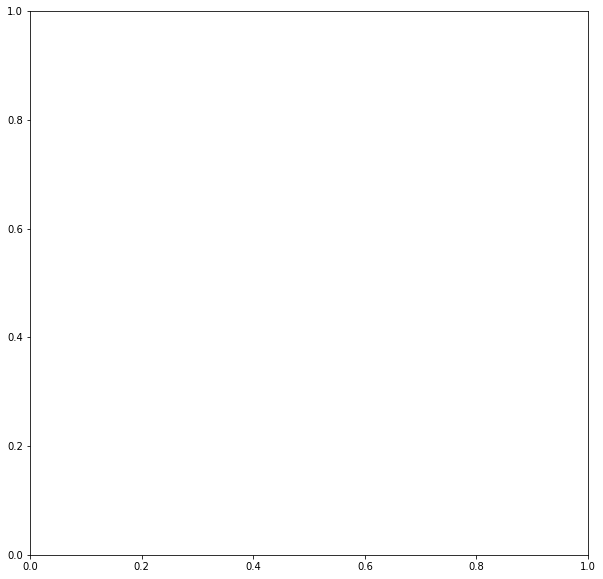

In [119]:
fig,ax=plt.subplots()

ax=df.plot(kind="scatter", x="lon", y="lat",
    s=df['act']/5, label="Estaciones",
    c="balance", cmap='seismic',
    colorbar=True, figsize=(100,100),
ax=ax,zorder=3,alpha=.9,vmin=-1,vmax=1
       )
for i, point in df.iterrows():
        ax.text(point['lon'], point['lat'], str(point['name']))

lc = mcoll.LineCollection(segments,array=df4['num_viajes'],cmap='viridis_r',linewidth=15*df4['num_viajes'].values/392,alpha=.5,zorder=1)
cdmx_img=mpimg.imread('mapa_rectangular.png')
plt.imshow(cdmx_img, extent=[-99.22, -99.13, 19.35, 19.45])
ax.add_collection(lc)
#plt.colorbar(lc,orientation='horizontal')
#metro.plot(c='orange',markersize=1000,ax=ax,zorder=2)

# Se añade la red del metro

In [96]:
import os
os.listdir('estaciones-metro')

['estaciones-metro.shx',
 'estaciones-metro.shp',
 'estaciones-metro.dbf',
 'estaciones-metro.prj']

In [46]:
import geopandas as gpd
metro=gpd.read_file('estaciones-metro/estaciones-metro.shp')
metroviz=metro.loc[(metro.stop_lat>19.35)&(metro.stop_lat<19.45)&(metro.stop_lon<-99.13)&(metro.stop_lon>-99.22)]
import numpy as np
import matplotlib.image as mpimg

OSError: no such file or directory: 'estaciones-metro/estaciones-metro.shp'

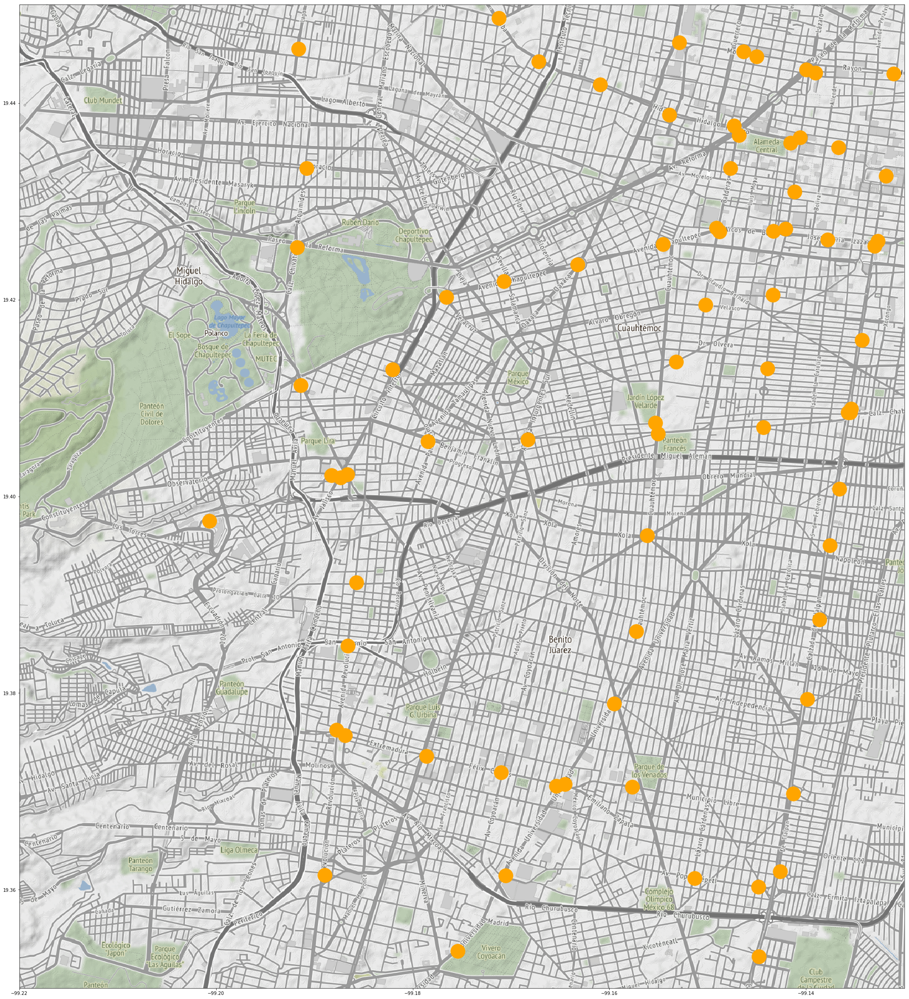

In [34]:

fig,ax=plt.subplots()

cdmx_img=mpimg.imread('mapa_rectangular.png')
plt.imshow(cdmx_img, extent=[-99.22, -99.13, 19.35, 19.45])
metroviz.plot(c='orange',markersize=1000,ax=ax)

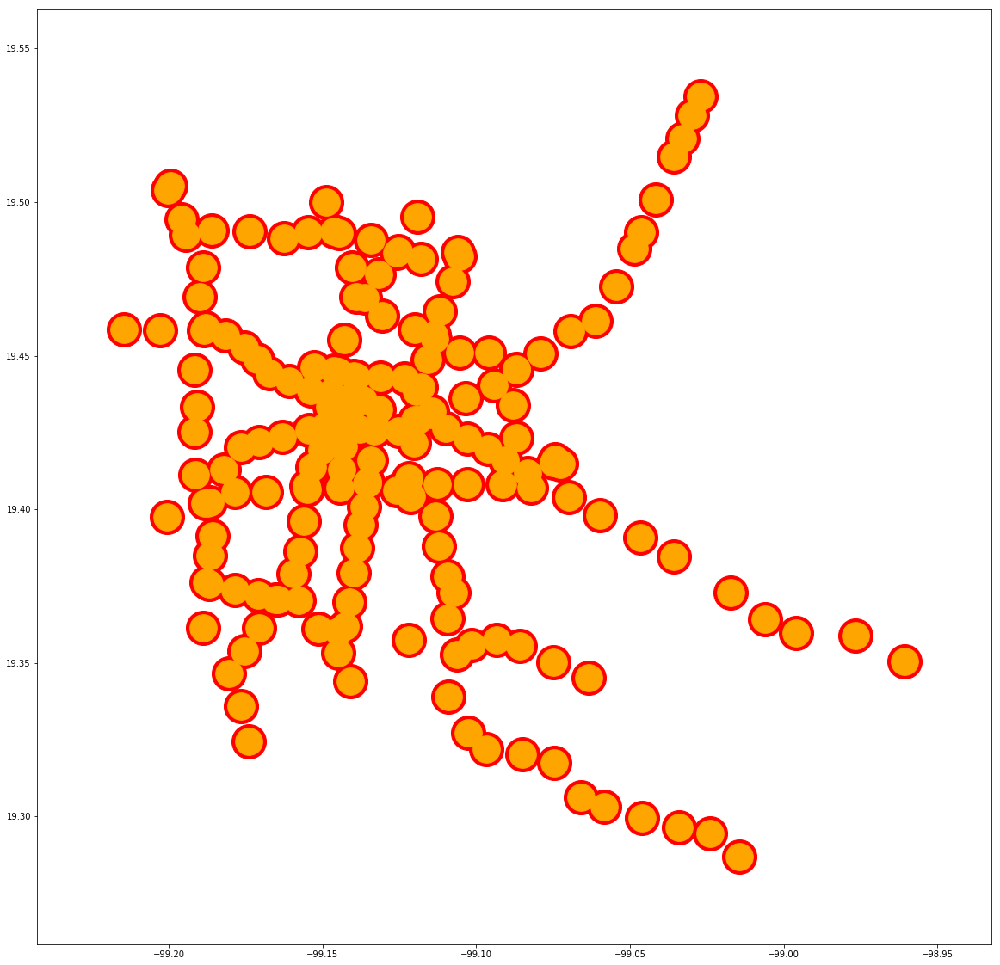

In [29]:
ax=metro.plot(c='orange',figsize=(20,20),markersize=1000,zorder=10)
metro.plot(c='red',figsize=(20,20),markersize=1600,zorder=0,ax=ax)

In [161]:
df.loc[268:278]

,id,lat,lon,name,num_arribos,num_retiros,act,balance
268,269,19.442448,-99.151586,269 LUIS DONALDO COLOSIO-ALDAMA,598.0,661.0,1259.0,-0.050040
269,270,19.436760,-99.153870,270 DE LA REPUBLICA-PONCIANO ARRIAGA,2871.0,3052.0,5923.0,-0.030559
270,271,19.443928,-99.152525,271 AV. CENTRAL-J. MENESES,4997.0,6903.0,11900.0,-0.160168
271,272,19.443556,-99.152556,272 AV. CENTRAL-J. MENESES,1966.0,2620.0,4586.0,-0.142608
272,273,19.442707,-99.152956,273 LUIS DONALDO COLOSIO-AV. CENTRAL,886.0,676.0,1562.0,0.134443
273,274,19.442772,-99.153289,274 LUIS DONALDO COLOSIO-AV INSURGENTES NORTE,1552.0,1268.0,2820.0,0.100709
274,275,19.441062,-99.153164,275 HÉROES FERROCARRILEROS-AV. INSURGENTES NORTE,537.0,626.0,1163.0,-0.076526
275,276,19.401986,-99.156366,276 ANAXÁGORAS-OBRERO MUNDIAL,1915.0,1766.0,3681.0,0.040478
276,277,19.401807,-99.159090,277 AMPLIACIÓN TONALÁ-OBRERO MUNDIAL,1152.0,1116.0,2268.0,0.015873
277,278,19.400710,-99.163831,278 MIER Y PESADO-OBRERO MUNDIAL,907.0,852.0,1759.0,0.031268


# Gráficas para entregable

In [2]:
import matplotlib.image as mpimg
import imageio

In [3]:
estaciones=pd.read_csv('data/stations.csv')
estaciones=estaciones.set_index('id')
estaciones.head()

,lat,lon,name
id,,,
1,19.433571,-99.167809,1 RIO SENA-RIO BALSAS
2,19.431386,-99.171695,2 RIO GUADALQUIVIR-RIO BALSAS
3,19.431655,-99.158668,3 REFORMA-INSURGENTES
4,19.428309,-99.171713,4 RIO NILO-RIO PANUCO
5,19.429720,-99.169363,5 RIO PANUCO-RIO TIBER


In [37]:
dia=pd.read_csv('data/12-06-19.csv')
dia['act']=dia['n_retiro']+dia['n_arribo']
dia['balance']=(dia['n_arribo']-dia['n_retiro'])/dia['act']


In [ ]:
dia['hora']=pd.to_datetime(dia['hora'], format='%Y-%m-%d %H:%M:%S')

dia=dia.join(estaciones,on='estacion')
dia.head()

In [22]:
dia['hora'][400].hour
plt.rcParams['figure.figsize'] = (10, 10)

Timestamp('2019-06-12 06:00:00')

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


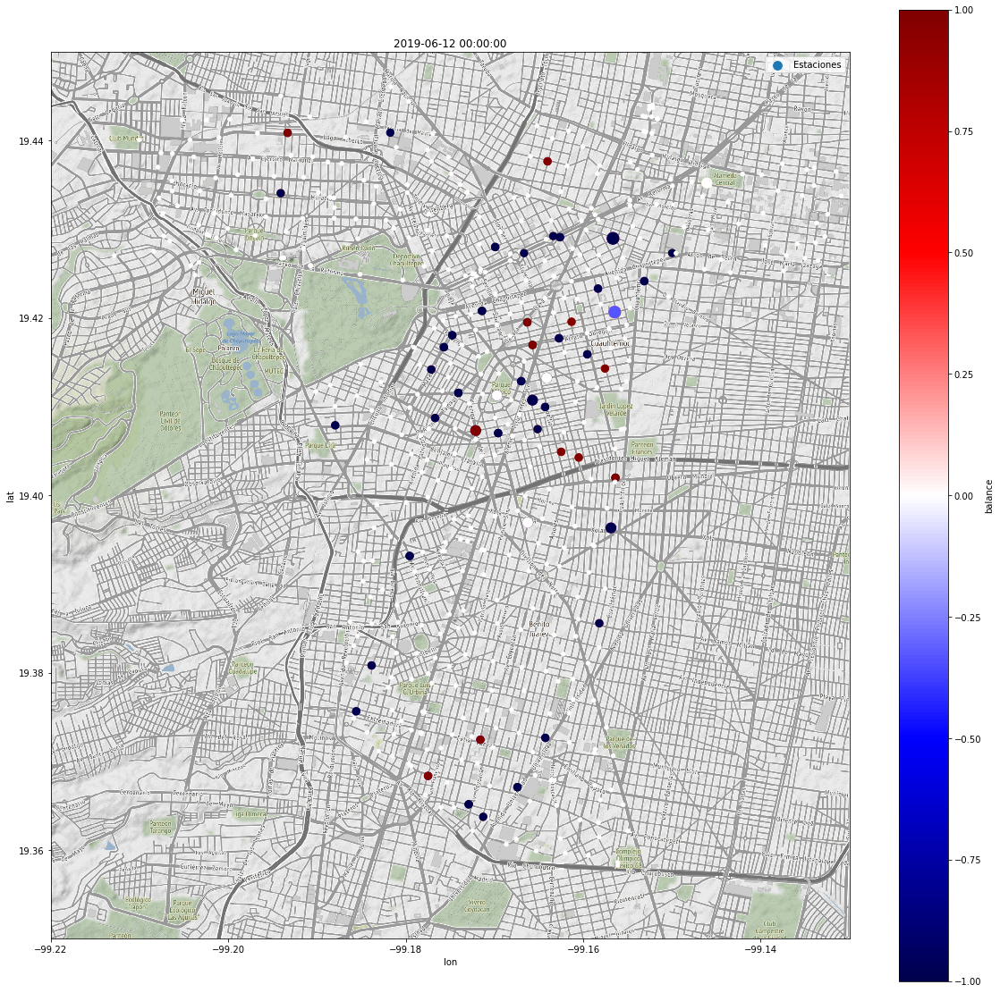

In [ ]:
images=[]
cdmx_img=mpimg.imread('data/mapa_rectangular.png')
for hora,group in tqdm_notebook(dia.groupby(by='hora')):
    group=group.set_index('estacion')
    aux=estaciones.join(group,how='left',on='id')
    
    
    aux['act']=aux['act'].fillna(0)
    aux['capacity']=aux['capacity'].fillna(0)
    aux['balance']=aux['balance'].fillna(0)
    aux['estado']=aux['estado'].fillna(0)
    aux.head(10)

    fig,ax=plt.subplots()

    ax=aux.plot(kind="scatter", x="lon", y="lat",
        s=aux['act']*50+20, label="Estaciones",
        c="balance", cmap='seismic',
        colorbar=True, figsize=(20,20),
    ax=ax,zorder=3,vmin=-1,vmax=1
           )

    ax=aux.plot(kind="scatter", x="lon", y="lat",
        s=aux['act']*52+20,
        c=(aux['capacity']-aux['estado'])/aux['capacity'],cmap='magma',colorbar=False,
    ax=ax,zorder=2
           )
    ax.set_title(hora)

    plt.imshow(cdmx_img, extent=[-99.22, -99.13, 19.35, 19.45])


    
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    images.append(image)
kwargs_write = {'fps':1.0, 'quantizer':'nq'}
imageio.mimsave('map.gif', images, fps=2)

In [201]:
imageio.mimsave('map.gif', images, fps=1)

In [ ]:
imageio.mimsave('map.gif', images, fps=2)

In [48]:
plt.rcParams['figure.figsize'] = (10, 10)
grupos

,hora,n_retiro,n_arribo,districtName,capacity,inicial,estado,act,balance
estacion,,,,,,,,,
9,2019-06-12 00:00:00,1,0,Ampliación Granada,24.0,18.0,17.0,1,-1.000000
19,2019-06-12 00:00:00,1,0,Ampliación Granada,24.0,5.0,4.0,1,-1.000000
25,2019-06-12 00:00:00,1,0,Ampliación Granada,27.0,4.0,3.0,1,-1.000000
27,2019-06-12 00:00:00,1,0,Ampliación Granada,36.0,24.0,23.0,1,-1.000000
38,2019-06-12 00:00:00,1,0,Ampliación Granada,34.0,29.0,28.0,1,-1.000000
43,2019-06-12 00:00:00,1,1,Ampliación Granada,33.0,1.0,1.0,2,0.000000
44,2019-06-12 00:00:00,1,0,Ampliación Granada,26.0,21.0,20.0,1,-1.000000
47,2019-06-12 00:00:00,0,1,Ampliación Granada,24.0,17.0,18.0,1,1.000000
49,2019-06-12 00:00:00,1,0,Ampliación Granada,36.0,29.0,28.0,1,-1.000000


In [110]:
grupos=dia.loc[dia['hora']=='2019-06-12 00:00:00']
grupos=grupos.set_index('estacion')
aux=estaciones.join(grupos,how='left',on='id')
aux['act']=aux['act'].fillna(0)
aux['capacity']=aux['capacity'].fillna(1)
aux['balance']=aux['balance'].fillna(0)
aux['estado']=aux['estado'].fillna(0)
aux.head(10)

,lat,lon,name,hora,n_retiro,n_arribo,districtName,capacity,inicial,estado,act,balance
id,,,,,,,,,,,,
1,19.433571,-99.167809,1 RIO SENA-RIO BALSAS,NaN,NaN,NaN,NaN,1.0,NaN,0.0,0.0,0.0
2,19.431386,-99.171695,2 RIO GUADALQUIVIR-RIO BALSAS,NaN,NaN,NaN,NaN,1.0,NaN,0.0,0.0,0.0
3,19.431655,-99.158668,3 REFORMA-INSURGENTES,NaN,NaN,NaN,NaN,1.0,NaN,0.0,0.0,0.0
4,19.428309,-99.171713,4 RIO NILO-RIO PANUCO,NaN,NaN,NaN,NaN,1.0,NaN,0.0,0.0,0.0
5,19.429720,-99.169363,5 RIO PANUCO-RIO TIBER,NaN,NaN,NaN,NaN,1.0,NaN,0.0,0.0,0.0
6,19.430922,-99.166959,6 RIO PANUCO-RIO SENA,NaN,NaN,NaN,NaN,1.0,NaN,0.0,0.0,0.0
7,19.425468,-99.175166,7 RIO ELBA-RIO LERMA,NaN,NaN,NaN,NaN,1.0,NaN,0.0,0.0,0.0
8,19.431141,-99.158317,8 REFORMA-GENERAL PRIM,NaN,NaN,NaN,NaN,1.0,NaN,0.0,0.0,0.0
9,19.428009,-99.169918,9 RIO GUADALQUIVIR-RIO LERMA,2019-06-12 00:00:00,1.0,0.0,Ampliación Granada,24.0,18.0,17.0,1.0,-1.0


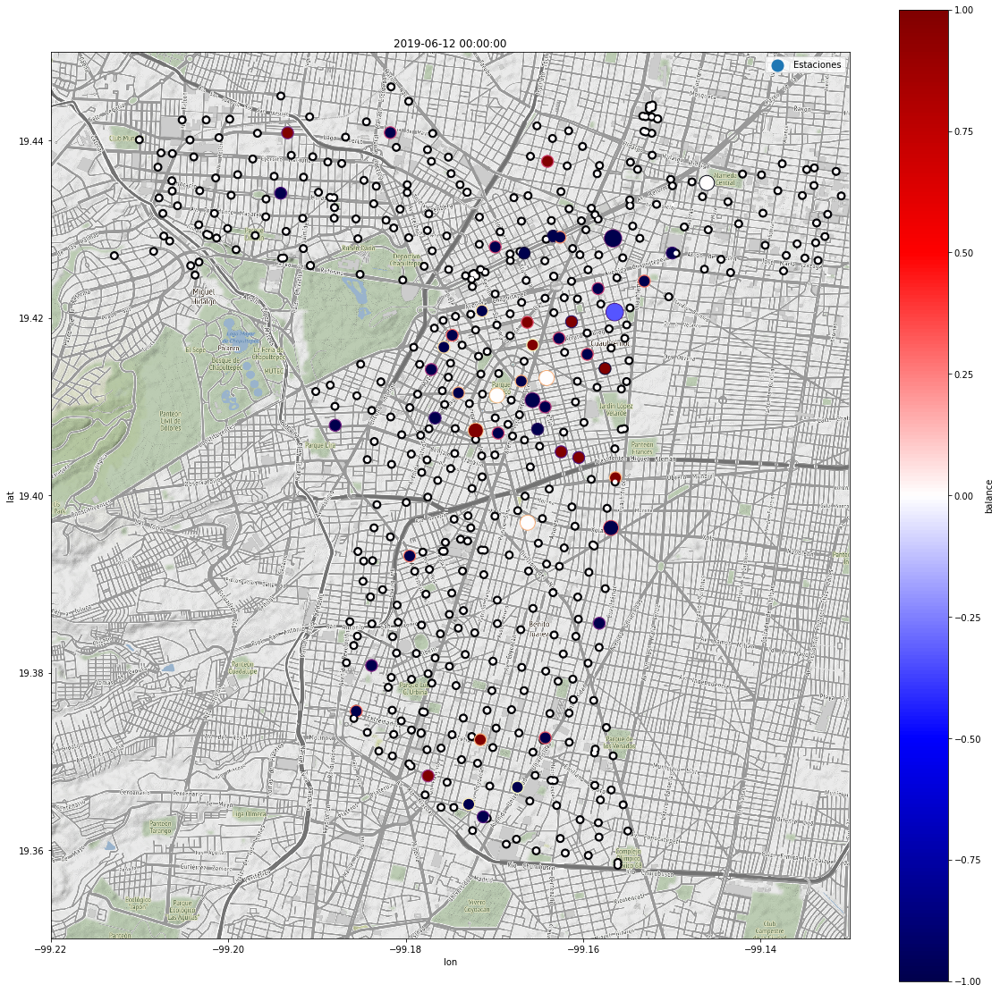

In [117]:

fig,ax=plt.subplots()

ax=aux.plot(kind="scatter", x="lon", y="lat",
    s=aux['act']*100+20, label="Estaciones",
    c="balance", cmap='seismic',
    colorbar=True, figsize=(20,20),
ax=ax,zorder=3,vmin=-1,vmax=1
       )

ax=aux.plot(kind="scatter", x="lon", y="lat",
    s=aux['act']*100+80,
    c=aux['estado'],cmap='magma',colorbar=False,
ax=ax,zorder=2
       )
ax.set_title('2019-06-12 00:00:00')

plt.imshow(cdmx_img, extent=[-99.22, -99.13, 19.35, 19.45])


In [ ]:
lc = mcoll.LineCollection(segments,array=df4['num_viajes'],cmap='viridis',linewidth=15*df4['num_viajes'].values/392,alpha=.5,zorder=1)

ax.add_collection(lc)
#plt.colorbar(lc,orientation='horizontal')
#metro.plot(c='orange',markersize=1000,ax=ax,zorder=2)

## Gif

In [19]:
import matplotlib.image as mpimg
import imageio

In [3]:
estaciones=pd.read_csv('data/stations.csv')
estaciones=estaciones.set_index('id')
estaciones.head()

,lat,lon,name
id,,,
1,19.433571,-99.167809,1 RIO SENA-RIO BALSAS
2,19.431386,-99.171695,2 RIO GUADALQUIVIR-RIO BALSAS
3,19.431655,-99.158668,3 REFORMA-INSURGENTES
4,19.428309,-99.171713,4 RIO NILO-RIO PANUCO
5,19.429720,-99.169363,5 RIO PANUCO-RIO TIBER


In [10]:
dia.head()

,estacion,hora,n_retiro,n_arribo,retiros_60_min,arribos_60_min,districtName,capacity,inicial,cambio,estado
0,1,2019-06-12 00:00:00,0,0,NaN,NaN,NaN,27.0,16.0,0,16.0
1,2,2019-06-12 00:00:00,0,0,NaN,NaN,Ampliación Granada,12.0,8.0,0,8.0
2,3,2019-06-12 00:00:00,0,0,NaN,NaN,Ampliación Granada,36.0,30.0,0,30.0
3,4,2019-06-12 00:00:00,0,0,NaN,NaN,Ampliación Granada,15.0,6.0,0,6.0
4,5,2019-06-12 00:00:00,0,0,NaN,NaN,Ampliación Granada,12.0,7.0,0,7.0


In [27]:
dia=pd.read_csv('data/12-06-19.csv')
dia['retiros_60_min']=dia['retiros_60_min'].fillna(0)
dia['arribos_60_min']=dia['arribos_60_min'].fillna(0)
dia.head()

,estacion,hora,n_retiro,n_arribo,retiros_60_min,arribos_60_min,districtName,capacity,inicial,cambio,estado
0,1,2019-06-12 00:00:00,0,0,0.0,0.0,NaN,27.0,16.0,0,16.0
1,2,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,12.0,8.0,0,8.0
2,3,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,36.0,30.0,0,30.0
3,4,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,15.0,6.0,0,6.0
4,5,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,12.0,7.0,0,7.0


In [28]:
dia['act_60_min']=dia['retiros_60_min']+dia['arribos_60_min']
dia['balance_60_min']=(dia['retiros_60_min']-dia['arribos_60_min'])/dia['act_60_min']
dia['balance_60_min']=dia['balance_60_min'].fillna(0)
dia=dia.join(estaciones,on='estacion')


,estacion,hora,n_retiro,n_arribo,retiros_60_min,arribos_60_min,districtName,capacity,inicial,cambio,estado,act_60_min,balance_60_min,lat,lon,name
0,1,2019-06-12 00:00:00,0,0,0.0,0.0,NaN,27.0,16.0,0,16.0,0.0,0.0,19.433571,-99.167809,1 RIO SENA-RIO BALSAS
1,2,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,12.0,8.0,0,8.0,0.0,0.0,19.431386,-99.171695,2 RIO GUADALQUIVIR-RIO BALSAS
2,3,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,36.0,30.0,0,30.0,0.0,0.0,19.431655,-99.158668,3 REFORMA-INSURGENTES
3,4,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,15.0,6.0,0,6.0,0.0,0.0,19.428309,-99.171713,4 RIO NILO-RIO PANUCO
4,5,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,12.0,7.0,0,7.0,0.0,0.0,19.429720,-99.169363,5 RIO PANUCO-RIO TIBER


In [34]:
dia.head(10)

,estacion,hora,n_retiro,n_arribo,retiros_60_min,arribos_60_min,districtName,capacity,inicial,cambio,estado,act_60_min,balance_60_min,lat,lon,name
0,1,2019-06-12 00:00:00,0,0,0.0,0.0,NaN,27.0,16.0,0,16.0,0.0,0.0,19.433571,-99.167809,1 RIO SENA-RIO BALSAS
1,2,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,12.0,8.0,0,8.0,0.0,0.0,19.431386,-99.171695,2 RIO GUADALQUIVIR-RIO BALSAS
2,3,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,36.0,30.0,0,30.0,0.0,0.0,19.431655,-99.158668,3 REFORMA-INSURGENTES
3,4,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,15.0,6.0,0,6.0,0.0,0.0,19.428309,-99.171713,4 RIO NILO-RIO PANUCO
4,5,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,12.0,7.0,0,7.0,0.0,0.0,19.429720,-99.169363,5 RIO PANUCO-RIO TIBER
5,6,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,14.0,10.0,0,10.0,0.0,0.0,19.430922,-99.166959,6 RIO PANUCO-RIO SENA
6,7,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,24.0,20.0,0,20.0,0.0,0.0,19.425468,-99.175166,7 RIO ELBA-RIO LERMA
7,8,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,12.0,6.0,0,6.0,0.0,0.0,19.431141,-99.158317,8 REFORMA-GENERAL PRIM
8,9,2019-06-12 00:00:00,1,0,0.0,0.0,Ampliación Granada,24.0,18.0,-1,17.0,0.0,0.0,19.428009,-99.169918,9 RIO GUADALQUIVIR-RIO LERMA
9,10,2019-06-12 00:00:00,0,0,0.0,0.0,Ampliación Granada,36.0,25.0,0,25.0,0.0,0.0,19.433321,-99.154752,10 REFORMA-RAMIREZ


### Ejemplo

In [21]:
cdmx_img=mpimg.imread('data/mapa_rectangular.png')

/Users/jeroaranda/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


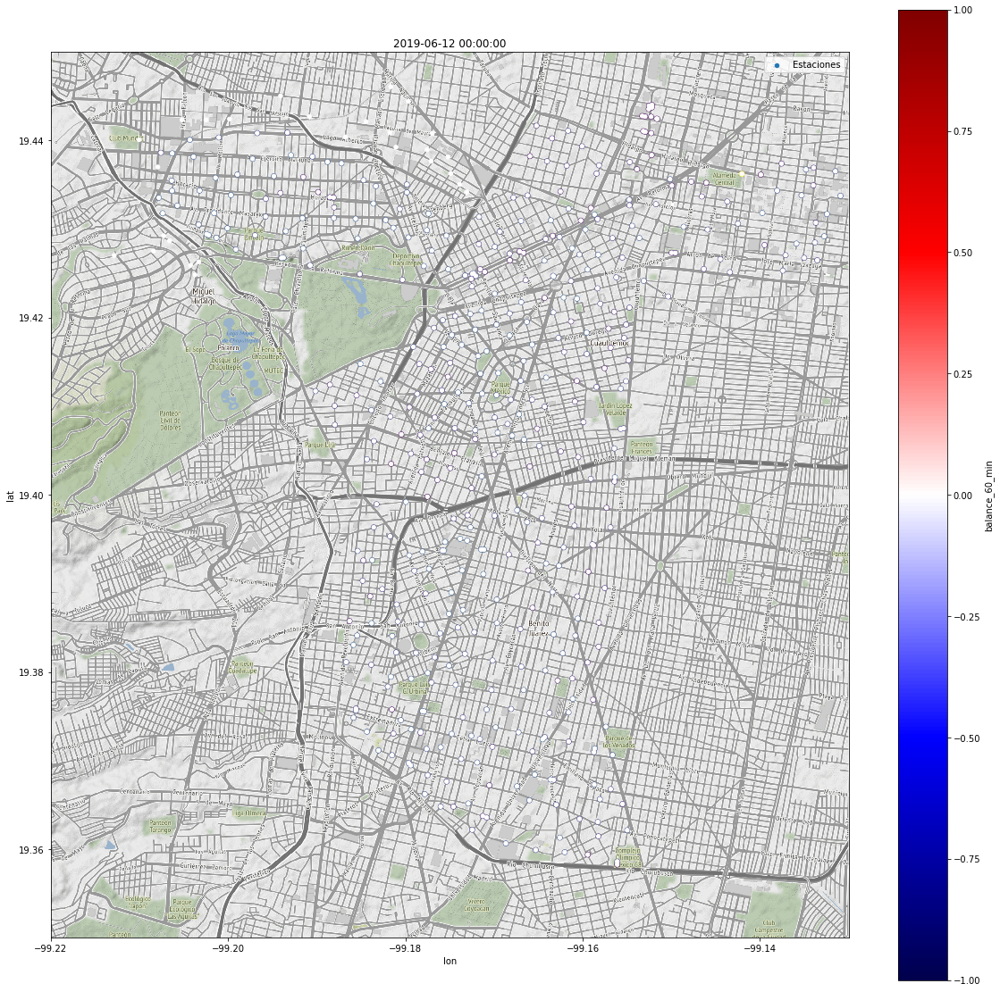

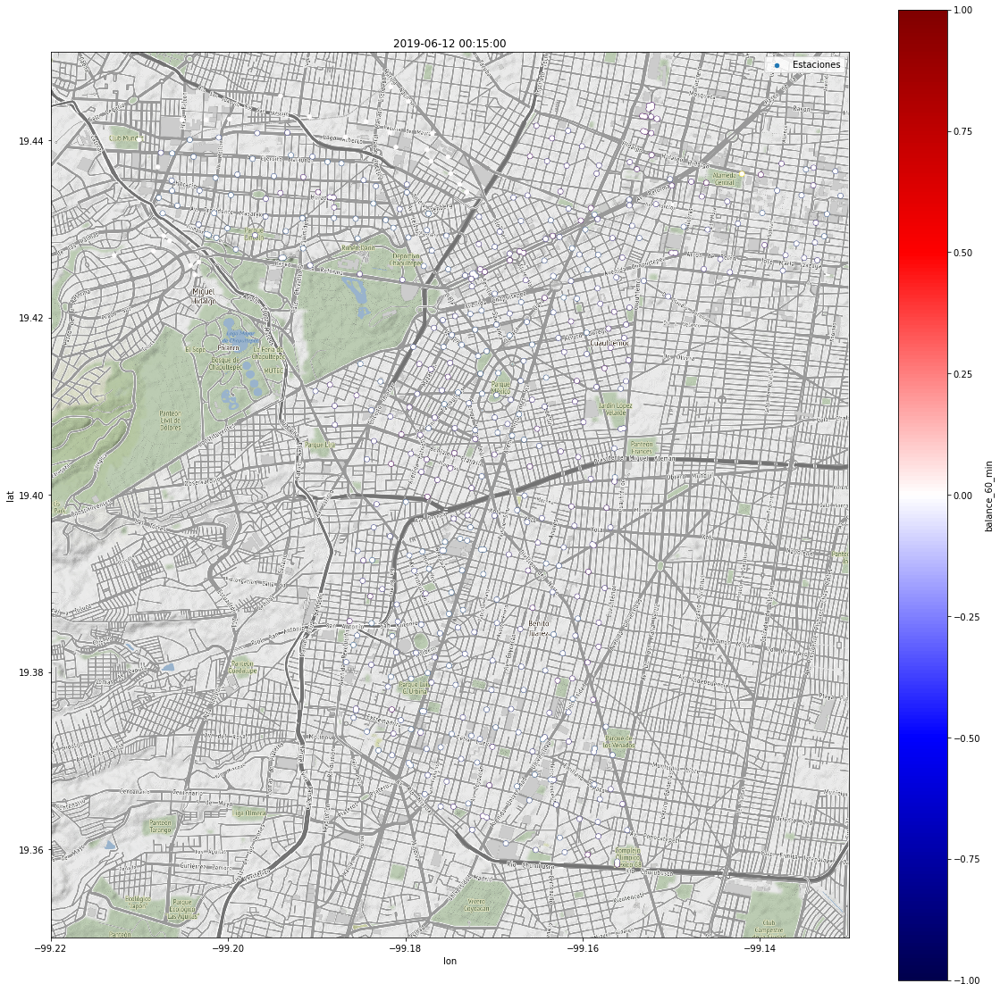

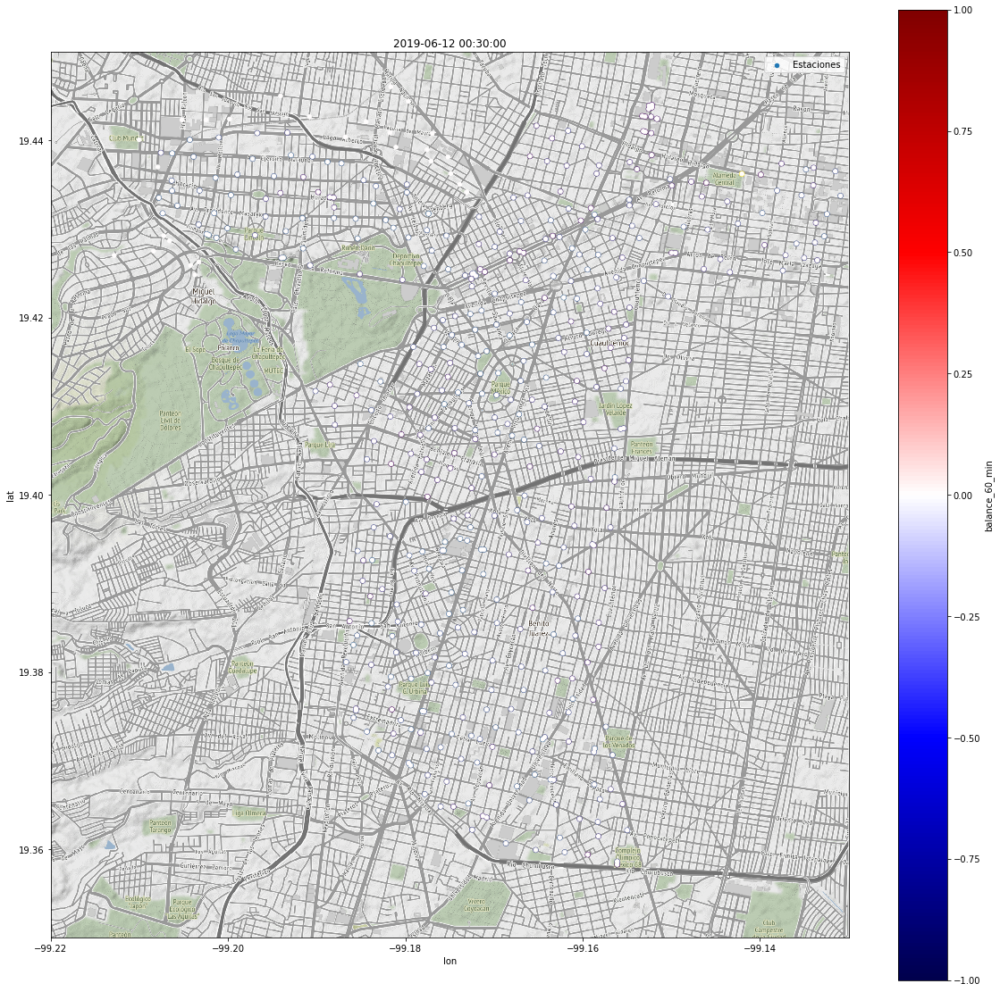

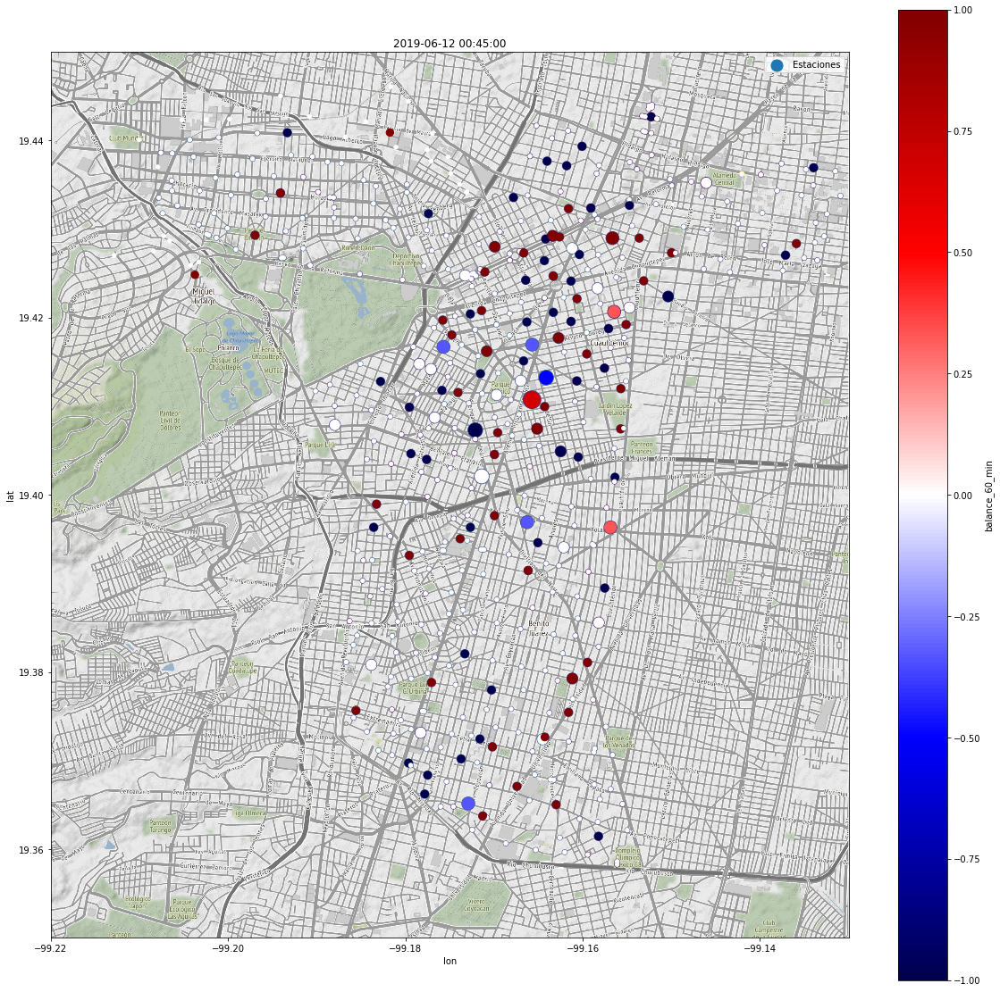

In [ ]:
images=[]
cdmx_img=mpimg.imread('data/mapa_rectangular.png')
for hora,group in tqdm_notebook(dia.groupby(by='hora')):
    aux=group

    fig,ax=plt.subplots()

    ax=aux.plot(kind="scatter", x="lon", y="lat",
        s=aux['act_60_min']*50+20, label="Estaciones",
        c="balance_60_min", cmap='seismic',
        colorbar=True, figsize=(20,20),
    ax=ax,zorder=4,vmin=-1,vmax=1
           )

    ax=aux.plot(kind="scatter", x="lon", y="lat",
        s=aux['act_60_min']*60+30,
        c=aux['estado']/aux['capacity'],cmap='viridis',colorbar=False,
    ax=ax,zorder=2
           )
    ax.set_title(hora)

    plt.imshow(cdmx_img, extent=[-99.22, -99.13, 19.35, 19.45])
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    images.append(image)
kwargs_write = {'fps':1.0, 'quantizer':'nq'}
imageio.mimsave('map.gif', images, fps=2)